# Advanced Plotting

In [1]:
import numpy as np
import matplotlib.pyplot as plt
# %matplotlib inline
plt.style.use('fivethirtyeight') # matplotlib stylesheets are awesome.
# plt.xkcd();

In [2]:
x = np.random.normal(size = (10000,))
y = np.random.beta(1.5,2, size = (10000,))

In [3]:
fig = plt.figure( figsize = (12,8) )
ax = fig.add_subplot( 111 )
ax.scatter(x,y,
           color='#DC6500',
           marker='o',      #marker shape
           alpha=1,         #Transparency
           s=150,           #Marker size
           edgecolors='k'); #Marker edgecolor
plt.title( 'Messy' )
plt.tight_layout()

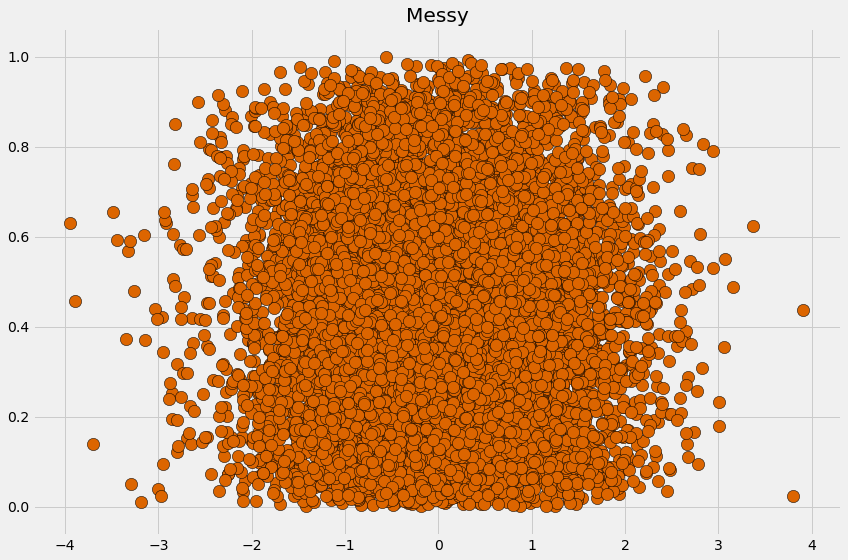

In [4]:
plt.show()

In [5]:
# Another useful method
params = {
    'x'         : x,
    'y'         : y,
    'color'     : '#DC6500',
    'marker'    : 'o',       #marker shape
    'alpha'     : .1,         #Transparency
    's'         : 150,       #Marker size
    'edgecolors': 'k'
}

fig = plt.figure(figsize=( 12, 8 ))
ax = fig.add_subplot( 111 )
ax.scatter( **params )
plt.title( 'Not as Messy' )
plt.tight_layout()

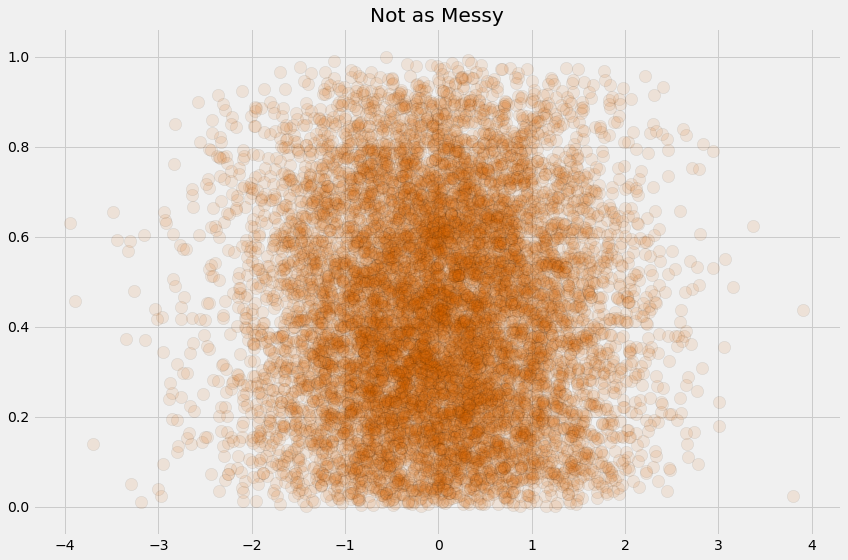

In [6]:
plt.show()

# Looping through subplots!

---

## Remember that rainfall plot from last week?

In [7]:
for i in range(1,13):
    sub_idx = ( int((( i - 1 ) / 4 )), int(( (i+3) % 4 )) )
    print(sub_idx)

(0, 0)
(0, 1)
(0, 2)
(0, 3)
(1, 0)
(1, 1)
(1, 2)
(1, 3)
(2, 0)
(2, 1)
(2, 2)
(2, 3)


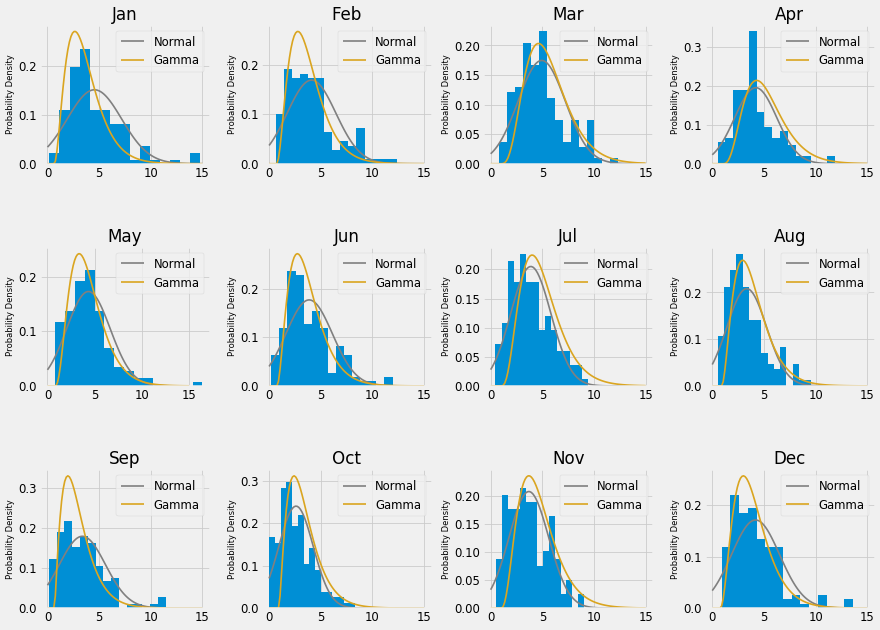

In [8]:
import pandas as pd
import scipy.stats as scs

rainfall = pd.DataFrame.from_csv('data/rainfall.csv')

fig, axarr = plt.subplots(3,4, figsize = (16,12), dpi = 60)
x = np.linspace(0, 15, 100)

for i in range(1,13):
    rainfall_month = rainfall[rainfall.columns[i-1]]
    
    #calculate stats for each month
    
    m_mean = rainfall_month.mean()
    m_std = rainfall_month.std()
    normal = scs.norm(m_mean, m_std)

    alpha = (m_mean**2)/(m_std**2)
    beta = (m_mean)/(m_std**2)
    gamma = scs.gamma(alpha,beta)
    
    # This line finds the index I want to plot on
    
    sub_idx = ( int((( i - 1 ) / 4 )), int(( (i+3) % 4 )) )

    '''
    Normalized histogram
    '''

    axarr[sub_idx].hist(rainfall_month, bins = 15, normed = 1, label = None)

    '''
    Normal Distribution
    '''

    axarr[sub_idx].plot(x, normal.pdf(x), label = 'Normal', color = 'grey', lw = 2)

    '''
    Gamma Distribution
    '''

    axarr[sub_idx].plot(x, gamma.pdf(x), label = 'Gamma', color = 'goldenrod', lw = 2)

    axarr[sub_idx].set_title(rainfall.columns[i-1])
    axarr[sub_idx].set_ylabel('Probability Density', fontsize = 10)

    axarr[sub_idx].legend()


plt.subplots_adjust(hspace = 0.6, wspace = 0.3)
plt.show()


---

# Seaborn

---

In [9]:
import seaborn as sns

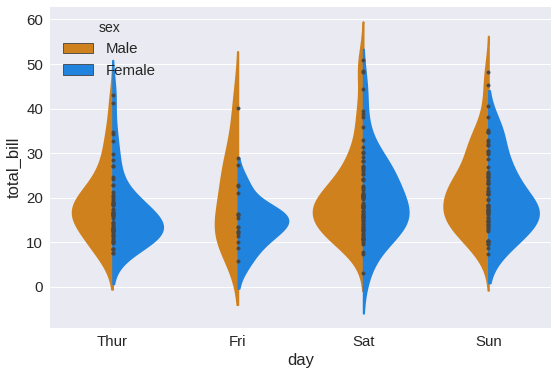

In [14]:
sns.set(font_scale=1.5) # Sets aesthetic params to defaults
tips = sns.load_dataset('tips')

# perc = tips.tip / tips.total_bill

# # Show each split-distribution with both violins and quartiles
sns.violinplot(x='day', y='total_bill', hue='sex', data=tips, split=True, palette={"Male": '#EC8500',"Female": '#0085FC'}, inner="points")
plt.show()

In [15]:
tips.columns
tips['perc'] = tips.tip/tips.total_bill

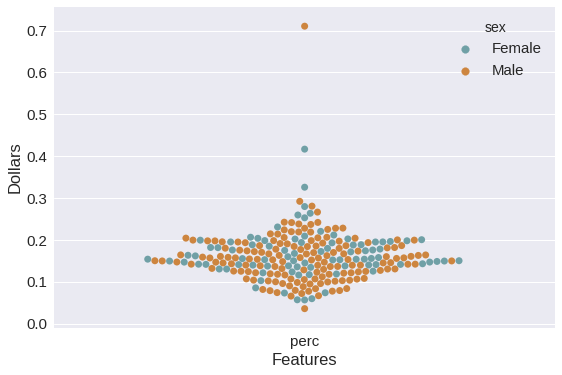

In [17]:
agg_tips = pd.melt(tips, id_vars="sex", value_vars=['perc'],value_name='Dollars',var_name = 'Features')
agg_tips.head()
sns.swarmplot(x = 'Features', y='Dollars',size = 7,hue='sex',palette={"Male":'#CD853F',"Female":'#70a0a6'},data=agg_tips)
plt.show()

---

# Plotly

---

#### We're going to use plotly to take a look at university graduate earnings

In [19]:
import plotly
import plotly.plotly as py
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs,init_notebook_mode,plot, iplot
init_notebook_mode()

In [21]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/school_earnings.csv")

In [22]:
df.head()

,School,Women,Men,gap
0,MIT,94,152,58
1,Stanford,96,151,55
2,Harvard,112,165,53
3,U.Penn,92,141,49
4,Princeton,90,137,47


In [23]:
# We make multiple traces in order to apply different styling
trace_women = Bar(x=df.School,
                  y=df.Women,
                  name='Women',
                  marker=dict(color='#ffcdd2'))

trace_men = Bar(x=df.School,
                y=df.Men,
                name='Men',
                marker=dict(color='#A2D5F2'))

trace_gap = Bar(x=df.School,
                y=df.gap,
                name='Gap',
                marker=dict(color='#59606D'))

data = [trace_women, trace_men, trace_gap]

In [24]:
layout = Layout(title="Average Earnings for Graduates",
                xaxis=dict(title='School'),
                yaxis=dict(title='Salary (in thousands)'))

fig = Figure(data=data, layout=layout)

In [34]:
iplot(fig, filename='jupyter/styled_bar',show_link=True)

## 3D plots in Plotly

---

In [29]:
# Initialize some data...
s = np.linspace(0, np.pi, 240)
t = np.linspace(0, np.pi, 240)
tGrid, sGrid = np.meshgrid(s, t)
a, b, c = 1,1,1

r = 2 + np.sin(5 * sGrid + 7 * tGrid)      # r = 2 + sin(7s+5t)
x = r * np.cos((sGrid)) * np.sin((tGrid))  # x = r*cos(s)*sin(t)
y = r * np.sin((sGrid)) * np.sin(tGrid)    # y = r*sin(s)*sin(t)
z = r * np.cos(tGrid)                      # z = r*cos(t)


In [31]:
surface = Surface(x=x, y=y, z=z)
data = Data([surface])
# surface.help()

In [32]:
layout = Layout(
    title='Parametric Plot',
    scene=Scene(
        xaxis=XAxis(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=False,
            backgroundcolor='rgb(230, 230,230)'
        ),
        yaxis=YAxis(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=False,
            backgroundcolor='rgb(230, 230,230)'
        ),
        zaxis=ZAxis(
            gridcolor='rgb(255, 255, 255)',
            zerolinecolor='rgb(255, 255, 255)',
            showbackground=False,
            backgroundcolor='rgb(230, 230,230)'
        )
    )
)

In [33]:
fig = Figure(data=data, layout=layout)
iplot(fig,show_link=False)

## Animated plots!

---

In [35]:
import time
from plotly.grid_objs import Grid, Column

url = 'https://raw.githubusercontent.com/plotly/datasets/master/gapminderDataFiveYear.csv'
dataset = pd.read_csv(url)

In [36]:
years_from_col = set(dataset['year'])
years_ints = sorted(list(years_from_col))
years = [str(year) for year in years_ints]
years.remove('1957')

# make list of continents
continents = []
for continent in dataset['continent']:
    if continent not in continents: 
        continents.append(continent)

columns = []
# make grid
for year in years:
    for continent in continents:
        dataset_by_year = dataset[dataset['year'] == int(year)]
        dataset_by_year_and_cont = dataset_by_year[dataset_by_year['continent'] == continent]
        for col_name in dataset_by_year_and_cont:
            # each column name is unique
            column_name = '{year}_{continent}_{header}_gapminder_grid'.format(
                year=year, continent=continent, header=col_name
            )
            a_column = Column(list(dataset_by_year_and_cont[col_name]), column_name)
            columns.append(a_column)

# upload grid
grid = Grid(columns)


In [37]:
figure = {
    'data': [],
    'layout': {},
    'frames': [],
    'config': {'scrollzoom': True}
}

# fill in most of layout
figure['layout']['xaxis'] = {'range': [30, 85], 'title': 'Life Expectancy', 'gridcolor': '#FFFFFF'}
figure['layout']['yaxis'] = {'title': 'GDP per Capita', 'type': 'log', 'gridcolor': '#FFFFFF'}
figure['layout']['hovermode'] = 'closest'
figure['layout']['plot_bgcolor'] = 'rgb(223, 232, 243)'

In [38]:
figure['layout']['slider'] = {
    'args': [
        'slider.value', {
            'duration': 400,
            'ease': 'cubic-in-out'
        }
    ],
    'initialValue': '1952',
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}

figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]


In [39]:
sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': 'Year:',
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

In [40]:
custom_colors = {
    'Asia': 'rgb(171, 99, 250)',
    'Europe': 'rgb(230, 99, 250)',
    'Africa': 'rgb(99, 110, 250)',
    'Americas': 'rgb(25, 211, 243)',
    #'Oceania': 'rgb(9, 255, 255)' 
    'Oceania': 'rgb(50, 170, 255)'
}

col_name_template = '{year}_{continent}_{header}_gapminder_grid'
year = 1952
for continent in continents:
    data_dict = {
        'xsrc': grid.get_column_reference(col_name_template.format(
            year=year, continent=continent, header='lifeExp'
        )),
        'ysrc': grid.get_column_reference(col_name_template.format(
            year=year, continent=continent, header='gdpPercap'
        )),
        'mode': 'markers',
        'textsrc': grid.get_column_reference(col_name_template.format(
            year=year, continent=continent, header='country'
        )),
        'marker': {
            'sizemode': 'area',
            'sizeref': 200000,
            'sizesrc': grid.get_column_reference(col_name_template.format(
                 year=year, continent=continent, header='pop'
            )),
            'color': custom_colors[continent]
        },
        'name': continent
    }
    figure['data'].append(data_dict)

In [41]:
custom_colors = {
    'Asia': 'rgb(171, 99, 250)',
    'Europe': 'rgb(230, 99, 250)',
    'Africa': 'rgb(99, 110, 250)',
    'Americas': 'rgb(25, 211, 243)',
    #'Oceania': 'rgb(9, 255, 255)' 
    'Oceania': 'rgb(50, 170, 255)'
}

init_notebook_mode(connected=True)
url = 'https://raw.githubusercontent.com/plotly/datasets/master/gapminderDataFiveYear.csv'
dataset = pd.read_csv(url)

years = ['1952', '1962', '1967', '1972', '1977', '1982', '1987', '1992', '1997', '2002', '2007']
# make list of continents
continents = []
for continent in dataset['continent']:
    if continent not in continents:
        continents.append(continent)
# make figure
figure = {
    'data': [],
    'layout': {},
    'frames': [],
    'config': {'scrollzoom': True}
}

# fill in most of layout
figure['layout']['xaxis'] = {'range': [30, 85], 'title': 'Life Expectancy'}
figure['layout']['yaxis'] = {'title': 'GDP per Capita', 'type': 'log'}
figure['layout']['hovermode'] = 'closest'
figure['layout']['slider'] = {
    'args': [
        'slider.value', {
            'duration': 400,
            'ease': 'cubic-in-out'
        }
    ],
    'initialValue': '1952',
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}
figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]

sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': 'Year:',
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

# make data
year = 1952
for continent in continents:
    dataset_by_year = dataset[dataset['year'] == year]
    dataset_by_year_and_cont = dataset_by_year[dataset_by_year['continent'] == continent]

    data_dict = {
        'x': list(dataset_by_year_and_cont['lifeExp']),
        'y': list(dataset_by_year_and_cont['gdpPercap']),
        'mode': 'markers',
        'text': list(dataset_by_year_and_cont['country']),
        'marker': {
            'sizemode': 'area',
            'sizeref': 200000,
            'size': list(dataset_by_year_and_cont['pop']),
            'color': custom_colors[continent]
        },
        'name': continent
    }
    figure['data'].append(data_dict)
    
# make frames
for year in years:
    frame = {'data': [], 'name': str(year)}
    for continent in continents:
        dataset_by_year = dataset[dataset['year'] == int(year)]
        dataset_by_year_and_cont = dataset_by_year[dataset_by_year['continent'] == continent]

        data_dict = {
            'x': list(dataset_by_year_and_cont['lifeExp']),
            'y': list(dataset_by_year_and_cont['gdpPercap']),
            'mode': 'markers',
            'text': list(dataset_by_year_and_cont['country']),
            'marker': {
                'sizemode': 'area',
                'sizeref': 200000,
                'size': list(dataset_by_year_and_cont['pop']),
                'color': custom_colors[continent]
            },
            'name': continent
        }
        frame['data'].append(data_dict)

    figure['frames'].append(frame)
    slider_step = {'args': [
        [year],
        {'frame': {'duration': 300, 'redraw': False},
         'mode': 'immediate',
       'transition': {'duration': 300}}
     ],
     'label': year,
     'method': 'animate'}
    sliders_dict['steps'].append(slider_step)

    
figure['layout']['sliders'] = [sliders_dict]

iplot(figure, validate=False, show_link=False)

---

# Folium
### MapsMapsMapsMaps!!!

In [42]:
import folium

In [50]:
map1 = folium.Map(location=[38.8409, -105.0423], zoom_start=13, tiles=None)
folium.TileLayer('stamenterrain').add_to(map1);

In [51]:
folium.Marker([38.8409, -105.0423],
              popup="Pike's Peak",
              icon=folium.Icon(icon='cloud',color='green')
             ).add_to(map1);

In [52]:
map1

In [54]:
def conversion(old):
    direction = {'N':1, 'S':-1, 'E': 1, 'W':-1}
    new = old.replace(u'°',' ').replace('\'',' ').replace('"',' ').replace('′',' ').replace('″',' ')
    new = new.split()
    new_dir = new.pop()
    new.extend([0,0,0])
    return (int(new[0])+int(new[1])/60.0+int(new[2])/3600.0) * direction[new_dir]

In [57]:
mounts = pd.read_csv('CO14ers.csv')
mounts['Mountain'] = mounts.Mountain.apply(lambda x: x.split('/')[0])

mounts['lat'] = mounts.Coordinates.apply(lambda x: x.split()[0])
mounts['lon'] = mounts.Coordinates.apply(lambda x: x.split()[1])
mounts.lat = mounts.lat.apply(conversion)
mounts.lon = mounts.lon.apply(lambda x: conversion(x[:-1]))
names_locs = mounts[['Rank','Prominence (m)','Mountain','Height (ft)','Height (m)','lat','lon']]
# mounts.head()


In [58]:
world_mounts = folium.Map(location=[names_locs.lat[0],names_locs.lon[0]] , 
                          zoom_start=4,
                          tiles='Stamen Terrain'
                         );

for i in names_locs.index:
    folium.Marker(location = [names_locs.lat[i], names_locs.lon[i]],
#                         color = 'k',
                        popup=names_locs.Mountain[i]).add_to(world_mounts)
world_mounts

In [59]:
world_mounts = folium.Map(location=[names_locs.lat[0],names_locs.lon[0]] , 
                            zoom_start=3,
                            tiles='Stamen Terrain'
                           );
html="""
    <ol>
    <h3> {name}</h3>
    Rank: {r}
    Height: {h} m ({hft} ft)
    Prominence: {p} m
    </ol>
    """
for i in names_locs.index:
    iframe = folium.Html(data=html.format(name=names_locs.Mountain[i],
                                                    r=names_locs.Rank[i],
                                                    h=names_locs["Height (m)"][i],
                                                    hft=names_locs["Height (ft)"][i],
                                                    p=names_locs['Prominence (m)'][i]), script=True,width=250, height=100)
    popup = folium.Popup(iframe, max_width=265)
    folium.Marker(location = [names_locs.lat[i], names_locs.lon[i]],
                        icon=folium.Icon(icon='cloud',color = 'black'),
                        popup=popup).add_to(world_mounts)
world_mounts

In [60]:
'''
CIRCLE MARKER
'''

world_mounts = folium.Map(location=[names_locs.lat[0],names_locs.lon[0]] , 
                            zoom_start=5,
                            tiles='Stamen Terrain'
                           );
html="""
    <h1> {name}</h1>
    <p>
    Rank: {r}
    Height: {h} m ({hft} ft)
    Prominence: {p} m
    </p>
    """
for i in names_locs.index:
    iframe = folium.Html(data=html.format(name=names_locs.Mountain[i],
                                                    r=names_locs.Rank[i],
                                                    h=names_locs["Height (m)"][i],
                                                    hft=names_locs["Height (ft)"][i],
                                                    p=names_locs['Prominence (m)'][i]), script=True,width=250, height=100)
    popup = folium.Popup(iframe, max_width=265)
    folium.CircleMarker(location = [names_locs.lat[i], names_locs.lon[i]],
                        color = '#DF6500', weight=1,
                        radius=10,
                        popup=popup).add_to(world_mounts)
world_mounts

In [61]:
'''
CUSTOM ICON
'''
from folium.features import CustomIcon

world_mounts = folium.Map(location=[names_locs.lat[0],names_locs.lon[0]] , 
                            zoom_start=5,
                            tiles='Mapbox Control Room'
                           );
html="""
    <h1> {name}</h1>
    <p>
    Rank: {r}
    Height: {h} m ({hft} ft)
    Prominence: {p} m
    </p>
    """
icon_image='./mountain-icon.png'
from IPython.display import Image
# icon_image = Image(icon_image, width = 25, height = 25)
icon = CustomIcon(
    icon_image,
    icon_size=(25, 25),
    icon_anchor=(0, 0),
    popup_anchor=(-3, -76)
)
for i in names_locs.index:
    iframe = folium.Html(data=html.format(name=names_locs.Mountain[i],
                                                    r=names_locs.Rank[i],
                                                    h=names_locs["Height (m)"][i],
                                                    hft=names_locs["Height (ft)"][i],
                                                    p=names_locs['Prominence (m)'][i]), script=True,width=250, height=100)
    popup = folium.Popup(iframe, max_width=265)
    folium.Marker(location = [names_locs.lat[i], names_locs.lon[i]],
                        icon=folium.Icon(color="#DC6500",icon='chevron-up', prefix='fa',icon_color='black'),
                        popup=popup).add_to(world_mounts)
world_mounts

In [62]:
from folium.features import Template


class Map3d(folium.Map):

    def __init__(self, location=None, width='100%', height='100%', left='0%',
                 top='0%', position='relative', tiles='OpenStreetMap', API_key=None,
                 max_zoom=18, min_zoom=1, zoom_start=10, attr=None, min_lat=-90,
                 max_lat=90, min_lon=-180, max_lon=180, detect_retina=False, crs='EPSG3857'):
        super(Map3d, self).__init__(
            location=location, width=width, height=height,
            left=left, top=top, position=position, tiles=tiles,
            API_key=API_key, max_zoom=max_zoom, min_zoom=min_zoom,
            zoom_start=zoom_start, attr=attr, min_lat=min_lat,
            max_lat=max_lat, min_lon=min_lon, max_lon=max_lon,
            detect_retina=detect_retina, crs=crs
        )
        self._template = Template(u"""
        {% macro header(this, kwargs) %}
            <script src="https://www.webglearth.com/v2/api.js"></script>
            <style> #{{this.get_name()}} {
                position : {{this.position}};
                width : {{this.width[0]}}{{this.width[1]}};
                height: {{this.height[0]}}{{this.height[1]}};
                left: {{this.left[0]}}{{this.left[1]}};
                top: {{this.top[0]}}{{this.top[1]}};
                }
            </style>
        {% endmacro %}
        {% macro html(this, kwargs) %}
            <div class="folium-map" id="{{this.get_name()}}" ></div>
        {% endmacro %}

        {% macro script(this, kwargs) %}

            var southWest = L.latLng({{ this.min_lat }}, {{ this.min_lon }});
            var northEast = L.latLng({{ this.max_lat }}, {{ this.max_lon }});
            var bounds = L.latLngBounds(southWest, northEast);

            var {{this.get_name()}} = WE.map('{{this.get_name()}}', {
                                           center:[{{this.location[0]}},{{this.location[1]}}],
                                           zoom: {{this.zoom_start}},
                                           maxBounds: bounds,
                                           layers: [],
                                           crs: L.CRS.{{this.crs}}
                                         });
        {% endmacro %}
        """)


class TileLayer3d(folium.TileLayer):

    def __init__(self, tiles='OpenStreetMap', min_zoom=1, max_zoom=18, attr=None,
                 API_key=None, detect_retina=False, name=None, overlay=False, control=True):
        super(TileLayer3d, self).__init__(
            tiles=tiles, min_zoom=min_zoom, max_zoom=max_zoom,
            attr=attr, API_key=API_key, detect_retina=detect_retina,
            name=name, overlay=overlay, control=control
        )
        self._template = Template(u"""
        {% macro script(this, kwargs) %}
            var {{this.get_name()}} = WE.tileLayer(
                '{{this.tiles}}',
                {
                    maxZoom: {{this.max_zoom}},
                    minZoom: {{this.min_zoom}},
                    attribution: '{{this.attr}}',
                    detectRetina: {{this.detect_retina.__str__().lower()}}
                    }
                ).addTo({{this._parent.get_name()}});

        {% endmacro %}
        """)

In [63]:
import os
m = Map3d(location=[-42, -42], tiles=None, zoom_start=2)
m.add_child(TileLayer3d(tiles='Mapbox Control Room'))

# url = ('http://services.arcgisonline.com/arcgis/rest/services'
#        'Ocean/World_Ocean_Base'
#        'MapServer/tile/{z}/{y}/{x}')

# folium.TileLayer(
#     tiles=url,
#     name='World_Ocean_Base',
#     attr='ESRI',
#     overlay=True
# ).add_to(m)

for i in names_locs.index:
    iframe = folium.Html(data=html.format(name=names_locs.Mountain[i],
                                                    r=names_locs.Rank[i],
                                                    h=names_locs["Height (m)"][i],
                                                    hft=names_locs["Height (ft)"][i],
                                                    p=names_locs['Prominence (m)'][i]), script=True,width=250, height=100)
    popup = folium.Popup(iframe, max_width=265)
    folium.CircleMarker(location = [names_locs.lat[i], names_locs.lon[i]],
                        color = '#DF6500', weight=1,
                        radius=10,
                        popup=popup).add_to(m)
# m.save(os.path.join('results', 'Hacking_folium_3D_globe.html'))

m